In [ ]:
!cp -r -u /content/drive/MyDrive/celebaForModelXML /content/

^C


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np
import os
print("Mission finished!")
!unzip /content/celebaForModel-20210111T145135Z-001.zip
!unzip /content/celebaForModelXML-20210111T150438Z-001.zip

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: celebaForModelXML/train/004997.xml  
  inflating: celebaForModelXML/train/004998.xml  
  inflating: celebaForModelXML/train/004986.xml  
  inflating: celebaForModelXML/train/004983.xml  
  inflating: celebaForModelXML/train/004994.xml  
  inflating: celebaForModelXML/train/004990.xml  
  inflating: celebaForModelXML/train/004991.xml  
  inflating: celebaForModelXML/train/004982.xml  
  inflating: celebaForModelXML/train/004987.xml  
  inflating: celebaForModelXML/train/004988.xml  
  inflating: celebaForModelXML/train/004995.xml  
  inflating: celebaForModelXML/train/004984.xml  
  inflating: celebaForModelXML/train/004981.xml  
  inflating: celebaForModelXML/train/004992.xml  
  inflating: celebaForModelXML/train/004978.xml  
  inflating: celebaForModelXML/train/004976.xml  
  inflating: celebaForModelXML/train/004979.xml  
  inflating: celebaForModelXML/train/004989.xml  
  inflating: celebaFor

In [ ]:
print("Number of images decompressed in drive is: "+ str(len(os.listdir("/content/celebaForModelXML/val"))))


Number of images decompressed in drive is: 2001


In [ ]:
!rm -r /content/celebaForModel/
!rm -r /content/celebaForModelXML
#!mkdir /content/celebaForModel
#!mkdir /content/celebaForModelXML
#!mkdir /content/celebaForModel/train
#!mkdir /content/celebaForModelXML/train
#!mkdir /content/celebaForModel/val
#!mkdir /content/celebaForModelXML/val
print("Mission finished!")

Mission finished!


In [ ]:
base_img = "/content/celebaForModel/"
base_xml = "/content/celebaForModelXML/"

def transform_x(x,b):
  return int((224.0/b)*x)

def transform_y(x,b):
  return int((224.0/b)*x)


def creat_xml(filename,xmin,xmax,ymin,ymax,TrainOrVal):
  imge = Image.open("/content/img_celeba_ancienne/"+filename+".jpg")
  imge_width = imge.size[0]
  imge_height = imge.size[1]
  wanted_width = 224
  wanted_height = 224
  newimge=imge.resize((wanted_width,wanted_height))
  newimge.save(base_img+TrainOrVal+"/"+filename+".jpg")
  a = open(base_xml+TrainOrVal+"/"+filename + ".xml","w+")
  a.write("<annotation>\n")
  a.write("<folder>celebAunziped</folder>\n")
  a.write("<filename>"+str(filename)+".jpg</filename>\n")
  a.write("<source>\n")
  a.write("<database>CelebA Database</database>\n")
  a.write("<annotation>CelebA</annotation>\n")
  a.write("<image>flickr</image>\n")
  a.write("</source>\n")
  a.write("<size>\n")
  a.write("<width>224</width>\n")
  a.write("<height>224</height>\n")
  a.write("<depth>3</depth>\n")
  a.write("</size>\n")
  a.write("<segmented>1</segmented>\n")
  a.write("<object>\n")
  a.write("<name>face</name>\n")
  a.write("<pose>Unspecified</pose>\n")
  a.write("<truncated>1</truncated>\n")
  a.write("<difficult>0</difficult>\n")
  a.write("<bndbox>\n")
  a.write("<xmin>"+str(transform_x(xmin,imge_width))+"</xmin>\n")
  a.write("<ymin>"+str(transform_y(ymin,imge_height))+"</ymin>\n")
  a.write("<xmax>"+str(transform_x(xmax,imge_width))+"</xmax>\n")
  a.write("<ymax>"+str(transform_y(ymax,imge_height))+"</ymax>\n")
  a.write("</bndbox>\n")
  a.write("</object>\n")
  a.write("</annotation>\n")
  a.close()

print("Mission finished!")

Mission finished!


In [ ]:
print("Number of images: "+ str(len(os.listdir("/content/drive/MyDrive/celebAunziped/img_celeba_ancienne/"))))


Number of images: 47349


In [ ]:
bbox = open("/content/drive/MyDrive/CelebA/Anno/list_bbox_celeba.txt","r")
from PIL import UnidentifiedImageError
import errno
print("training dataset is being prepared")
j = -2
for line in bbox:
  j=j+1
  if j>=1:
    try:
      infos = line.split()
      widthbox = int(infos[3])
      heightbox = int(infos[4])
      xmin = int(infos[1])
      xmax = xmin + widthbox
      ymin = int(infos[2])
      ymax = ymin + heightbox
      if j < 10:  
        creat_xml("00000"+str(j),xmin,xmax,ymin,ymax,"train")
      elif j>=10 and j<100:
        creat_xml("0000"+str(j),xmin,xmax,ymin,ymax,"train")
      elif j<1000 and j>=100:
        creat_xml("000"+str(j),xmin,xmax,ymin,ymax,"train")
      elif j<10000 and j>=1000:
        creat_xml("00"+str(j),xmin,xmax,ymin,ymax,"train")
      elif j<100000 and j>=10000:
        creat_xml("0"+str(j),xmin,xmax,ymin,ymax,"train")
      elif j<1000000 and j>=100000:
        creat_xml(str(j),xmin,xmax,ymin,ymax,"val")
    except (UnidentifiedImageError, IOError):
      pass
  if j==45000:
    break
bbox.close()
print("Training dataset has been successfully prepared")

print("Validation dataset is being prepared")
j = -2
bbox = open("/content/drive/MyDrive/CelebA/Anno/list_bbox_celeba.txt","r")
for line in bbox:
  j=j+1
  try:
    if j>=45001:
      infos = line.split()
      widthbox = int(infos[3])
      heightbox = int(infos[4])
      xmin = int(infos[1])
      xmax = xmin + widthbox
      ymin = int(infos[2])
      ymax = ymin + heightbox
      if j < 10:  
        creat_xml("00000"+str(j),xmin,xmax,ymin,ymax,"val")
      elif j>=10 and j<100:
        creat_xml("0000"+str(j),xmin,xmax,ymin,ymax,"val")
      elif j<1000 and j>=100:
        creat_xml("000"+str(j),xmin,xmax,ymin,ymax,"val")
      elif j<10000 and j>=1000:
        creat_xml("00"+str(j),xmin,xmax,ymin,ymax,"val")
      elif j<100000 and j>=10000:
        creat_xml("0"+str(j),xmin,xmax,ymin,ymax,"val")
      elif j<1000000 and j>=100000:
        creat_xml(str(j),xmin,xmax,ymin,ymax,"val")
  except (UnidentifiedImageError, IOError):
    pass
  if j==47000:
    break
bbox.close()
print("Validation dataset has been successfully prepared")

print("Mission finished!")

training dataset is being prepared
Training dataset has been successfully prepared
Validation dataset is being prepared
Validation dataset has been successfully prepared
Mission finished!


In [ ]:
print("Number of .xml files for training in local folder is: "+ str(len(os.listdir("/content/celebaForModelXML/train"))))
print("Number of images for training in local folder is: "+ str(len(os.listdir("/content/celebaForModel/train"))))
print("Number of .xml files for validation in local folder is: "+ str(len(os.listdir("/content/celebaForModelXML/val"))))
print("Number of images for validation in local folder is: "+ str(len(os.listdir("/content/celebaForModel/val"))))

Number of .xml files for training in local folder is: 19999
Number of images for training in local folder is: 19999
Number of .xml files for validation in local folder is: 2001
Number of images for validation in local folder is: 2001


In [ ]:
#!cp -r /content/celebaForModel /content/drive/MyDrive
#!cp -r /content/celebaForModelXML /content/drive/MyDrive
!cp -r /content/drive/MyDrive/celebaForModelXML/ /content/
!cp -r /content/drive/MyDrive/celebaForModel/ /content/



In [ ]:
print("Number of .xml files for training in local folder is: "+ str(len(os.listdir("/content/celebaForModelXML/train"))))
print("Number of images for training in local folder is: "+ str(len(os.listdir("/content/celebaForModel/train"))))
print("Number of .xml files for validation in local folder is: "+ str(len(os.listdir("/content/celebaForModelXML/val"))))
print("Number of images for validation in local folder is: "+ str(len(os.listdir("/content/celebaForModel/val"))))


print("Number of .xml files for training in google drive folder is: "+ str(len(os.listdir("/content/drive/MyDrive/celebaForModelXML/train"))))
print("Number of images for training in google drive folder is: "+ str(len(os.listdir("/content/drive/MyDrive/celebaForModel/train"))))
print("Number of .xml files for validation in google drive folder is: "+ str(len(os.listdir("/content/drive/MyDrive/celebaForModelXML/val"))))
print("Number of images for validation in google drive folder is: "+ str(len(os.listdir("/content/drive/MyDrive/celebaForModel/val"))))


Number of .xml files for training in local folder is: 19999
Number of images for training in local folder is: 19999
Number of .xml files for validation in local folder is: 2001
Number of images for validation in local folder is: 2001
Number of .xml files for training in google drive folder is: 19999
Number of images for training in google drive folder is: 19999
Number of .xml files for validation in google drive folder is: 2001
Number of images for validation in google drive folder is: 2001


In [ ]:
!pip uninstall -y imgaug && pip uninstall -y albumentations && pip install imgaug==0.4
!git clone https://github.com/AIWintermuteAI/aXeleRate.git
import sys
sys.path.append('/content/aXeleRate')
from axelerate import setup_training, setup_inference

Uninstalling imgaug-0.2.9:
  Successfully uninstalled imgaug-0.2.9
Uninstalling albumentations-0.1.12:
  Successfully uninstalled albumentations-0.1.12
     |████████████████████████████████| 952kB 7.9MB/s 
Cloning into 'aXeleRate'...
remote: Enumerating objects: 80, done.
remote: Counting objects: 100% (80/80), done.
remote: Compressing objects: 100% (71/71), done.
remote: Total 2027 (delta 54), reused 20 (delta 9), pack-reused 1947
Receiving objects: 100% (2027/2027), 9.57 MiB | 22.84 MiB/s, done.
Resolving deltas: 100% (1304/1304), done.


Downloading...
From: https://drive.google.com/uc?id=1-ccBXBEUhyzG2_jopf6d13hTH9X7qpNl
To: /content/2020-04-12_17-09-43.h5
13.7MB [00:00, 43.6MB/s]


/usr/local/lib/python3.6/dist-packages/imgaug/imgaug.py:184: DeprecationWarning: Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.
  warn_deprecated(msg, stacklevel=3)


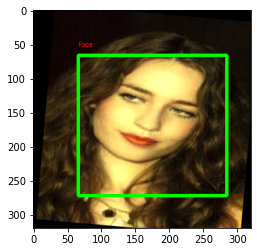

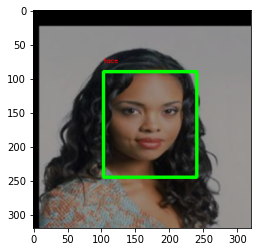

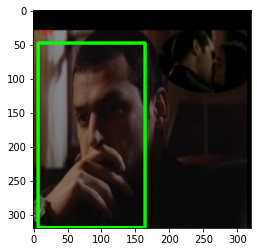

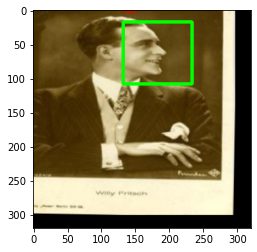

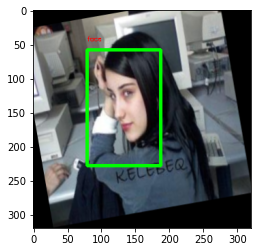

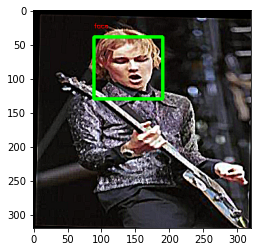

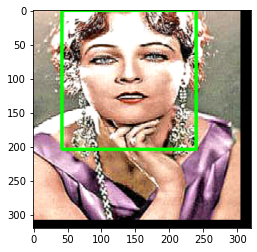

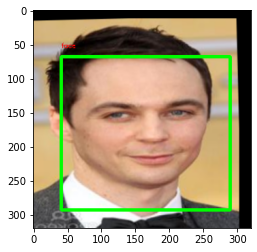

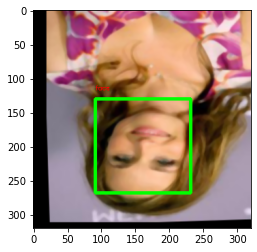

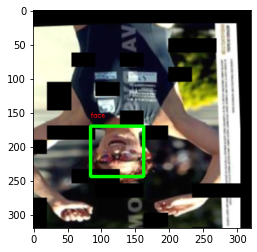

In [ ]:
%matplotlib inline
#!gdown https://drive.google.com/uc?id=1xgk7svdjBiEyzyUVoZrCz4PP6dSjVL8S  #pascal-voc dataset
!gdown https://drive.google.com/uc?id=1-ccBXBEUhyzG2_jopf6d13hTH9X7qpNl  #pre-trained model
#!unzip --qq pascal_20_detection.zip

from axelerate.networks.common_utils.augment import visualize_detection_dataset

visualize_detection_dataset(img_folder='/content/celebaForModel/train', ann_folder='/content/celebaForModelXML/train', num_imgs=10, img_size=320, augment=True)

In [ ]:
config = {
        "model":{
            "type":                 "Detector",
            "architecture":         "MobileNet7_5",
            "input_size":           224,
            "anchors":              [0.57273, 0.677385, 1.87446, 2.06253, 3.33843, 5.47434, 7.88282, 3.52778, 9.77052, 9.16828],
            "labels":               ["face"],
            "coord_scale" : 		1.0,
            "class_scale" : 		1.0,
            "object_scale" : 		5.0,
            "no_object_scale" : 	1.0
        },
        "weights" : {
            "full":   				"",
            "backend":   		    "imagenet"
        },
        "train" : {
            "actual_epoch":         15,
            "train_image_folder":   "/content/celebaForModel/train",
            "train_annot_folder":   "/content/celebaForModelXML/train",
            "train_times":          1,
            "valid_image_folder":   "/content/celebaForModel/val",
            "valid_annot_folder":   "/content/celebaForModelXML/val",
            "valid_times":          1,
            "valid_metric":         "mAP",
            "batch_size":           32,
            "learning_rate":        1e-4,
            "saved_folder":   		F"/content/drive/MyDrive/kendryteModel",
            "first_trainable_layer": "",
            "augumentation":				True,
            "is_only_detect" : 		False
        },
        "converter" : {
            "type":   				["k210","tflite"]
        }
    }

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs
!sleep 10

<IPython.core.display.Javascript object>

In [ ]:
from keras import backend as K 
K.clear_session()
model_path = setup_training(config_dict=config)

Project folder /content/drive/MyDrive/kendryteModel already exists. Creating a folder for new training session.
Tflite Converter ready
K210 Converter ready
['face']
Successfully loaded imagenet backend weights
Failed to load pre-trained weights for the whole model. It might be because you didn't specify any or the weight file cannot be found
Current training session folder is /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18


Model: "yolo"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 226, 226, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 24)      648       
_________________________________________________________________
conv1_bn (BatchNorma

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '
/usr/local/lib/python3.6/dist-packages/imgaug/imgaug.py:184: DeprecationWarning: Function `ContrastNormalization()` is deprecated. Use `imgaug.contrast.LinearContrast` instead.
  warn_deprecated(msg, stacklevel=3)


Epoch 1/15
624/624 [==============================] - 224s 340ms/step - loss: 0.9237 - val_loss: 0.2637


face 0.0000
mAP: 0.0000
Saving model on first epoch irrespective of mAP
Epoch 00000: Learning rate is 3.327991452991453e-05.

Epoch 2/15
624/624 [==============================] - 210s 334ms/step - loss: 0.2999 - val_loss: 0.1603


face 0.0623
mAP: 0.0623
mAP improved from 0 to 0.06232536128968433, saving model to /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.h5.
Epoch 00001: Learning rate is 6.661324786324786e-05.

Epoch 3/15
624/624 [==============================] - 210s 334ms/step - loss: 0.2006 - val_loss: 0.1184


face 0.6593
mAP: 0.6593
mAP improved from 0.06232536128968433 to 0.6593325272040358, saving model to /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.h5.
Epoch 00002: Learning rate is 9.99465811965812e-05.

Epoch 4/15
624/624 [==============================] - 210s 334ms/step - loss: 0.1550 - val_loss: 0.1125


face 0.8

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/backend.py:434: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


Converting to tflite without Reshape
/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.kmodel
/content/aXeleRate/axelerate/networks/common_utils/ncc/ncc compile "/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.tflite" "/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.kmodel" -i tflite --weights-quantize-threshold 1000 --dataset-format raw --dataset "/content/aXeleRate/axelerate/networks/common_utils/tmp"
1. Import graph...

2. Optimize Pass 1...

3. Optimize Pass 2...

4. Quantize...

  4.1. Add quantization checkpoints...

  4.2. Get activation ranges...

  Plan buffers...

  Run calibration...

  [>                                                 ] 0% 0s

  [>                                                 ] 0% 0.682s

  [>                                                 ] 0% 1.364s

  [>                                                 ] 0% 2.05s

  [>                                                 ] 1% 2.729s

  [> 

Folder /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results is created.
Loading pre-trained weights for the whole model:  /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/YOLO_best_mAP.h5
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020959.jpg saved.


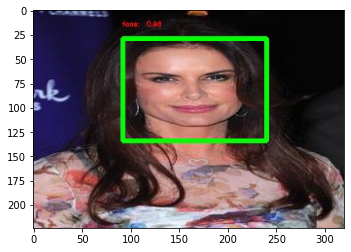

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020959.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020381.jpg saved.


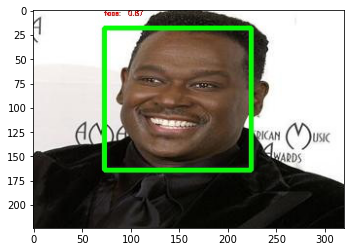

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020381.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021132.jpg saved.


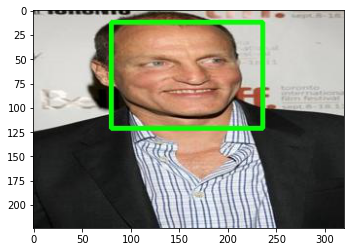

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021132.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020361.jpg saved.


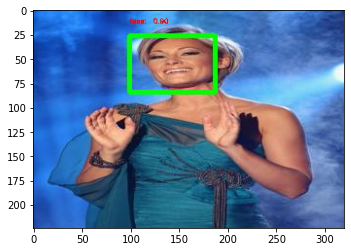

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020361.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020879.jpg saved.


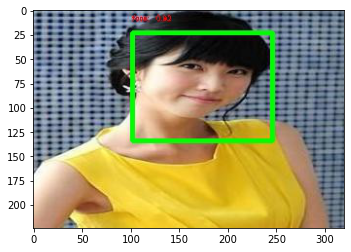

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020879.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021365.jpg saved.


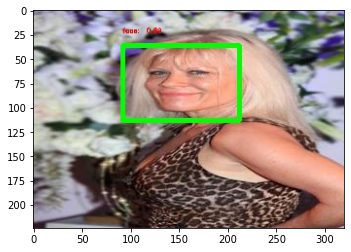

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021365.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020604.jpg saved.


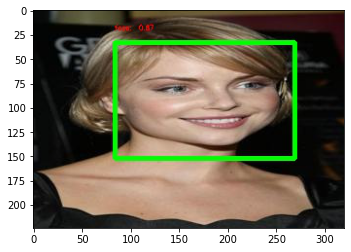

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020604.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020056.jpg saved.


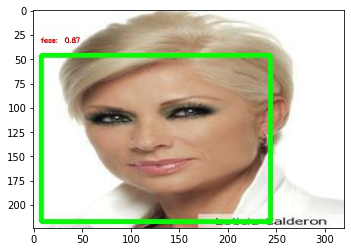

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020056.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021203.jpg saved.


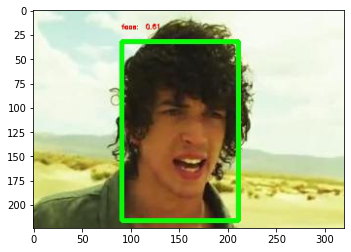

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021203.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020260.jpg saved.


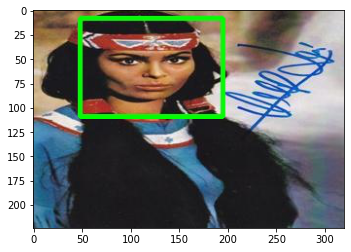

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020260.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021723.jpg saved.


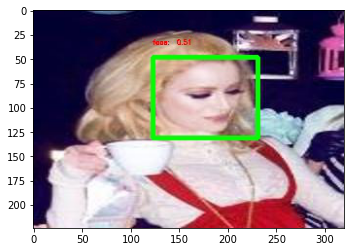

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021723.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021479.jpg saved.


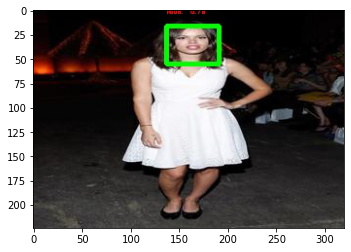

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021479.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021955.jpg saved.


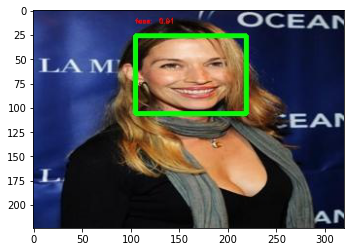

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021955.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020297.jpg saved.


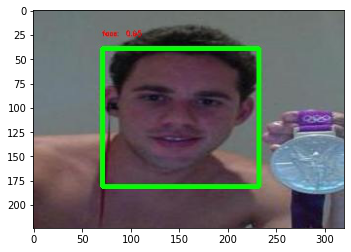

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020297.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020811.jpg saved.


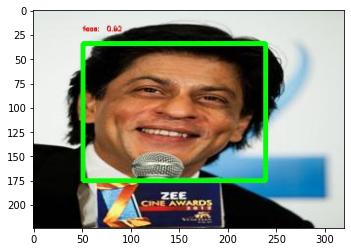

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020811.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020333.jpg saved.


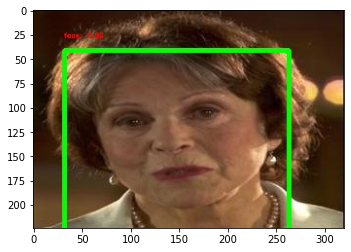

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020333.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021180.jpg saved.


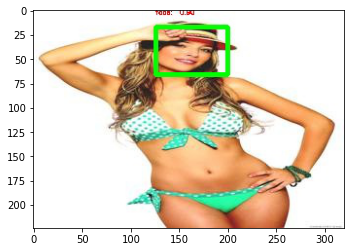

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021180.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021961.jpg saved.


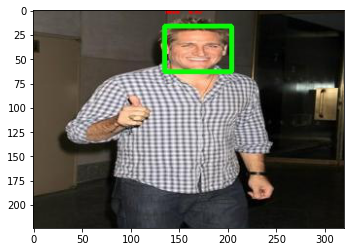

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021961.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020829.jpg saved.


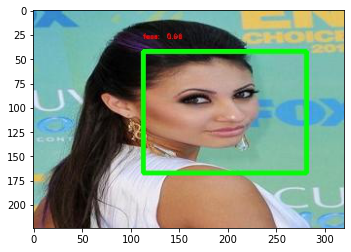

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020829.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021035.jpg saved.


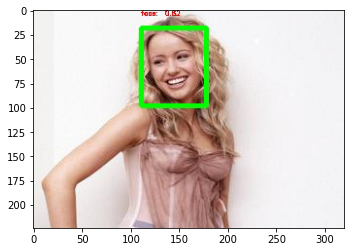

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021035.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021555.jpg saved.


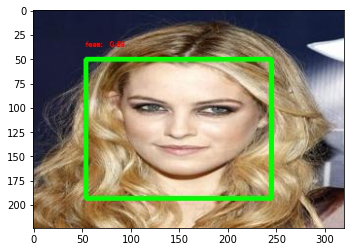

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021555.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021832.jpg saved.


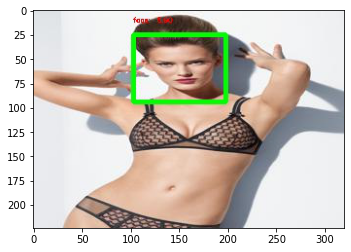

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021832.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021194.jpg saved.


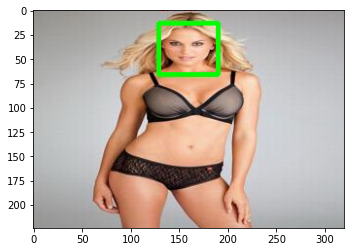

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021194.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020874.jpg saved.


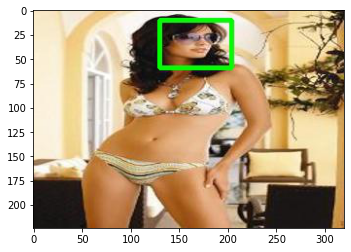

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020874.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020713.jpg saved.


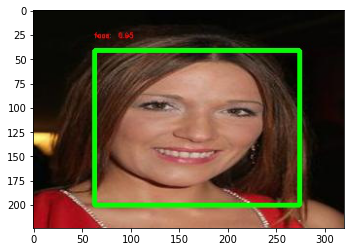

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020713.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020551.jpg saved.


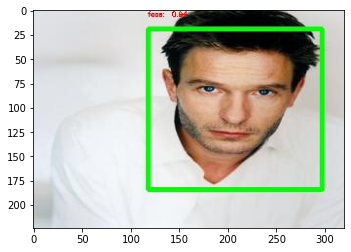

/content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/020551.jpg
1-boxes are detected. /content/drive/MyDrive/kendryteModel/2021-01-11_23-22-18/Inference_results/021517.jpg saved.


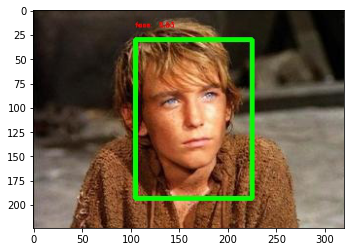

KeyboardInterrupt: ignored

In [ ]:
%matplotlib inline
from keras import backend as K 
K.clear_session()
setup_inference(config, model_path)

In [ ]:
from axelerate.networks.common_utils.convert import Converter
converter = Converter('openvino', 'MobileNet7_5', 'celebaForModel/val')
converter.convert_model(model_path)

OpenVINO Converter ready


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/backend.py:434: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


KeyboardInterrupt: ignored